## 导入库

In [4]:
# 基础数据处理和可视化
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# 机器学习相关
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.datasets import fetch_california_housing

# 深度学习相关
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

# XGBoost相关
import xgboost as xgb

# 超参数优化
import optuna
from optuna.samplers import TPESampler

# 其他工具
from datetime import datetime, timedelta
import os
import joblib

# 自定义模块
from plot import *
from process_read import *
from calculate import *

def pearson_correlation_coefficient(y_true, y_pred):
    """计算皮尔逊相关系数"""
    # 使用 numpy 的 corrcoef 函数
    return np.corrcoef(y_true, y_pred)[0, 1]

## 读取数据

### 读取预测气象数据

In [5]:
result = collect_filename(r'E:\USTC_New_Past\USTC_Now_Predict','SP30_32.02N-116.39E_')

file_paths = result
# print(file_paths)

dfs = [pd.read_csv(file, header=0,names=['time','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
        'predicted_pressure']) for file in file_paths]

# 初始化一个空的 DataFrame 来存储第1天的数据
first_day_data = pd.DataFrame()

# 遍历每个 DataFrame 并筛选第1天的数据
for df in dfs:
    # 将 'time' 列转换为 datetime 类型
    df['time'] = pd.to_datetime(df['time'])

    # 找到最小的时间点作为第一天的开始
    min_time = df['time'].min()

    first_day_start = min_time
    first_day_end  = first_day_start + timedelta(days=1)

    first_day_df =  df[(df['time'] >= first_day_start) & (df['time'] < first_day_end)]
    first_day_data = pd.concat([first_day_data, first_day_df], ignore_index=True)

# first_day_data["value_now"] = pd.to_numeric(first_day_data["value_now"], errors="coerce")  # 将非数值转为NaN
first_day_data['time'] = pd.to_datetime((first_day_data['time']), errors='coerce')


### 读取实测功率数据

2023年9月的数据点数量: 2865
2023年10月的数据点数量: 2976
2023年11月的数据点数量: 2789
2023年12月的数据点数量: 2871
2024年1月的数据点数量: 2731
2024年2月的数据点数量: 2777
2024年3月的数据点数量: 2976
2024年4月的数据点数量: 2871
2024年5月的数据点数量: 2976
2024年6月的数据点数量: 2872
2024年7月的数据点数量: 2976
2024年8月的数据点数量: 2976
2024年9月的数据点数量: 2874
2024年10月的数据点数量: 2975
2024年11月的数据点数量: 97


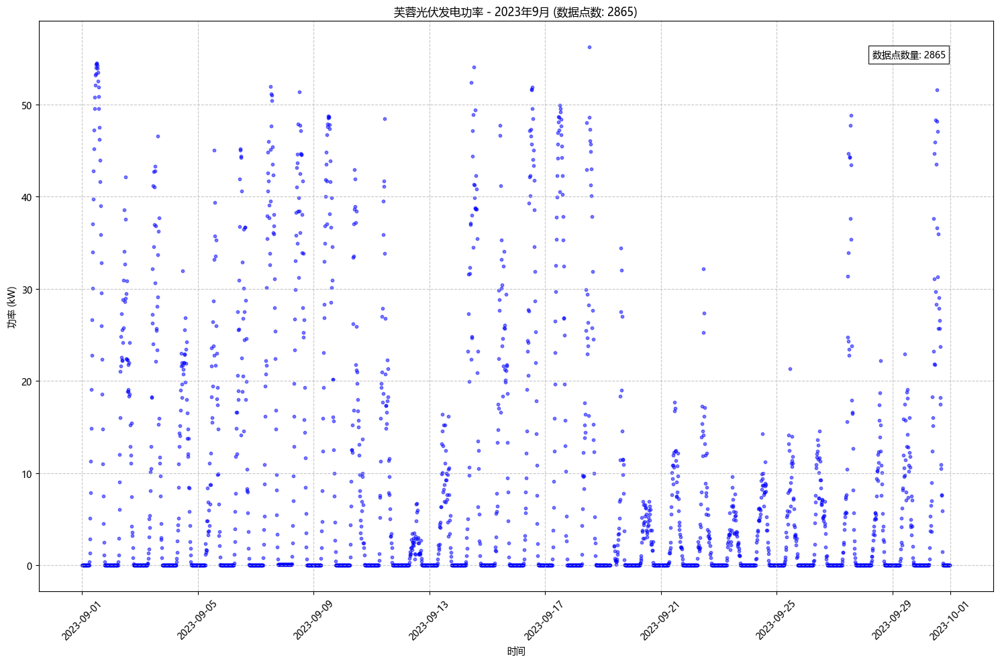

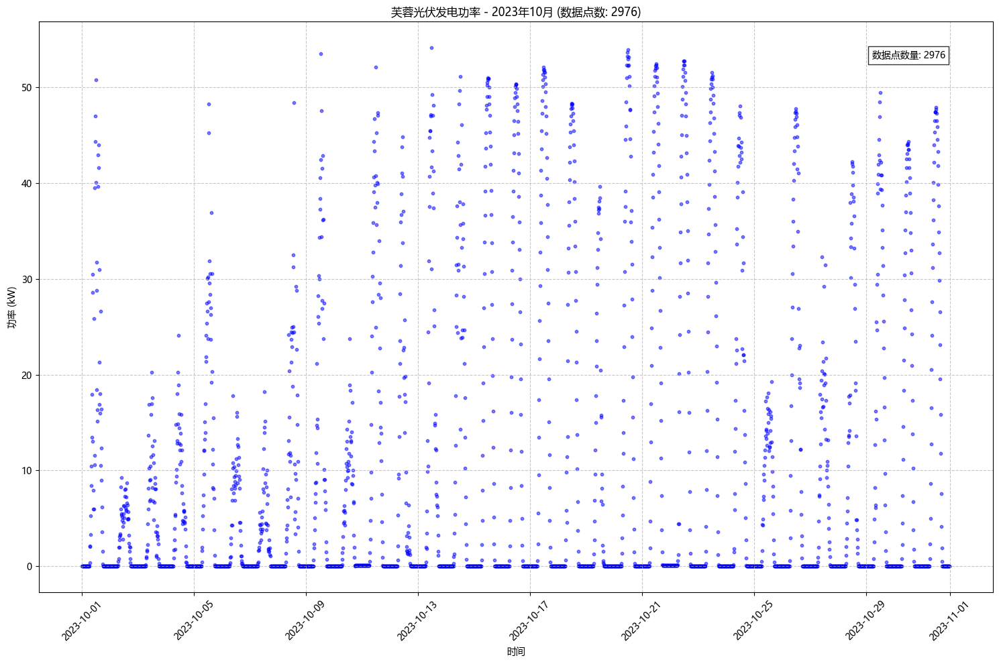

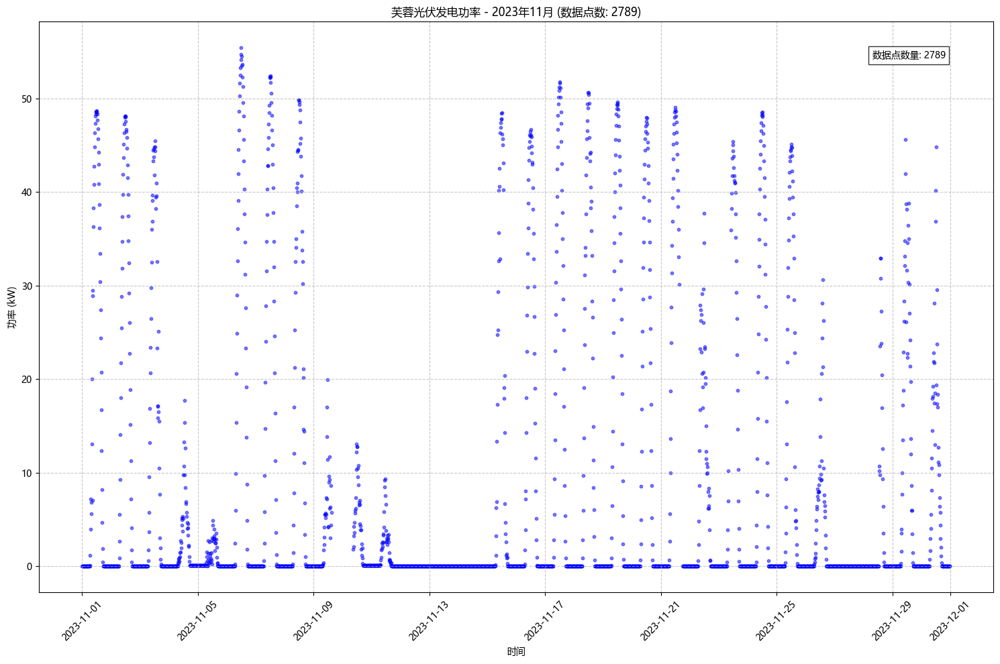

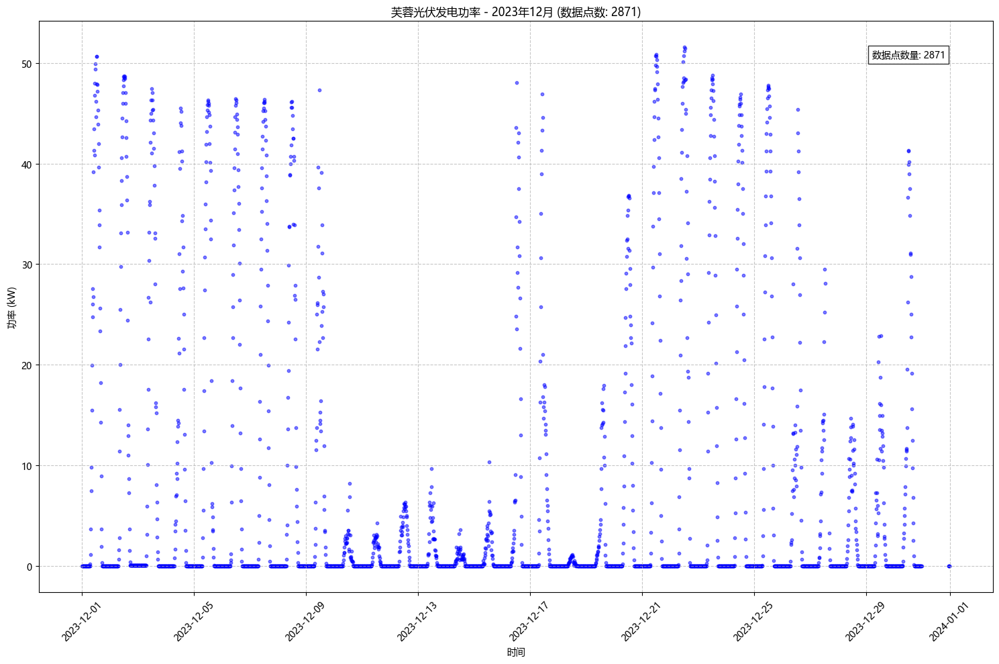

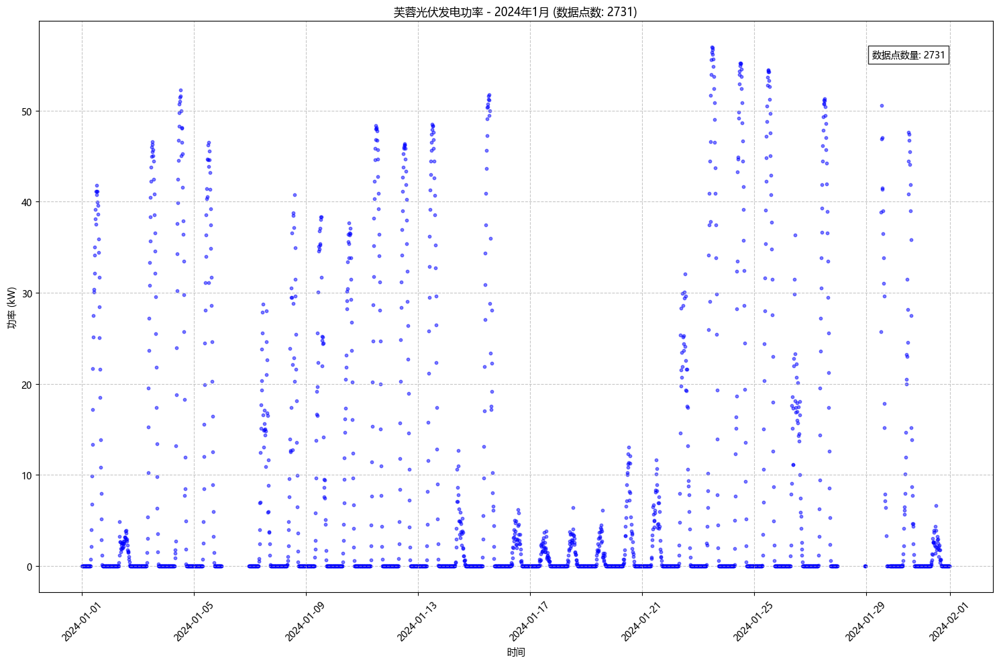

...

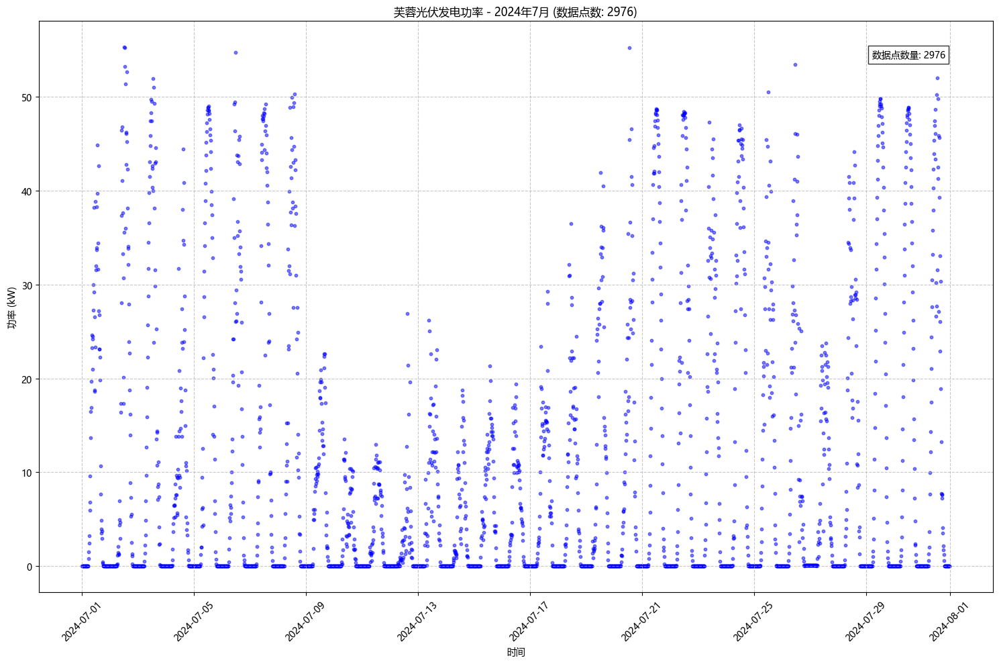

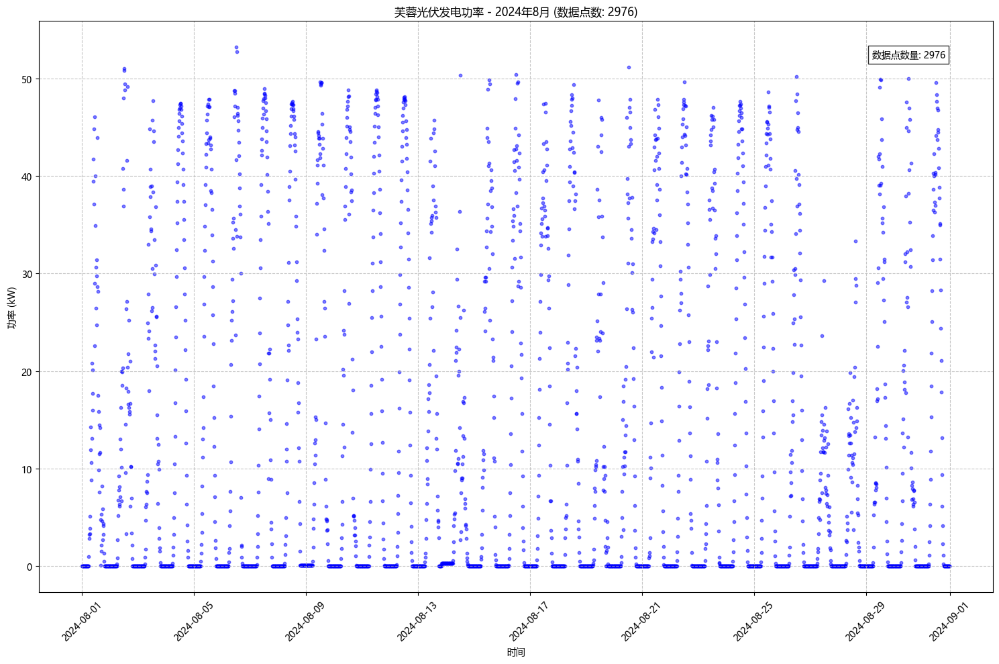

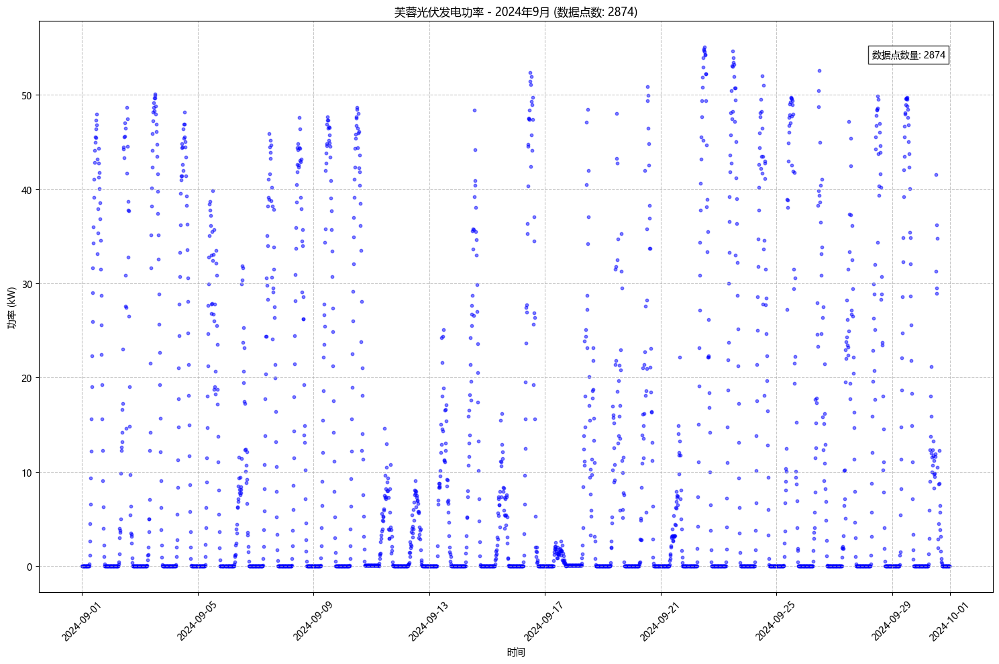

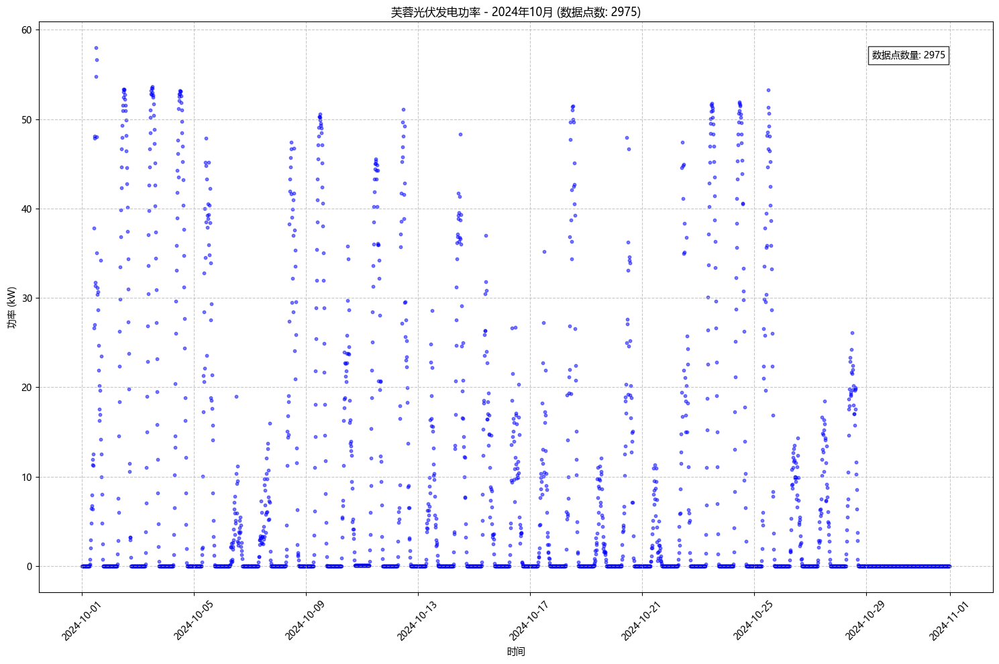

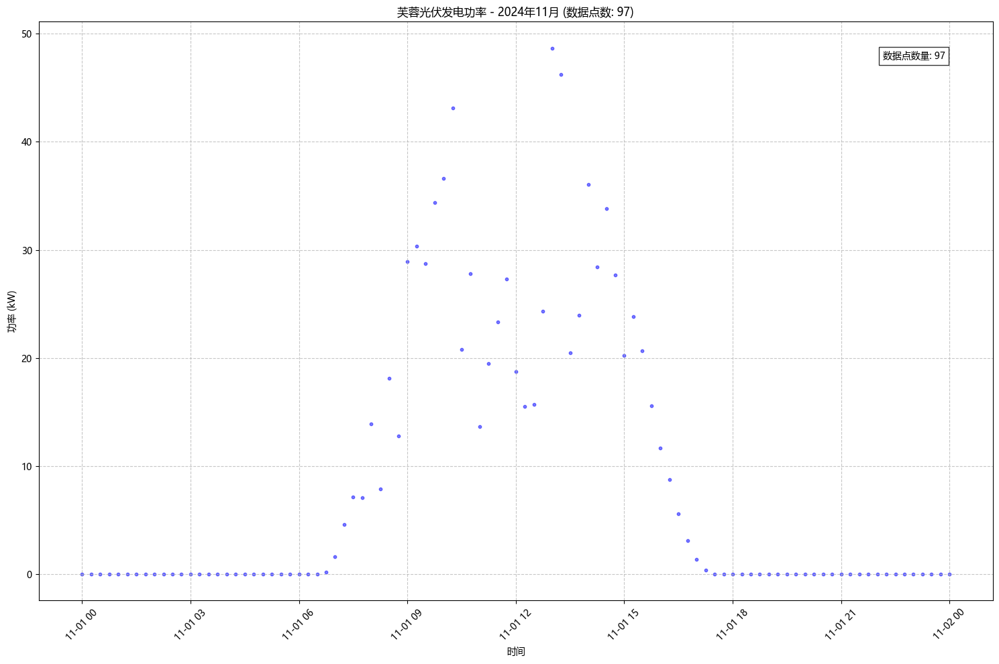

In [6]:
# 读取科大站点实测数据
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']

file_path = r'E:/Power_Pre_Model/actual_value/安徽.芙蓉光伏发电功率实测值.txt'

# 读取数据（假设数据分隔符为空格）
df = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
    names=["time", "power"]  # 直接指定列名
)
df['time'] = pd.to_datetime((df['time']), errors='coerce')
df.set_index('time', inplace=True)

#按15分钟重采样
mask = (df.index.minute%15 ==0) & (df.index.second == 0)
df = df.loc[mask]
# 按年月分别绘制散点图
years = df.index.year.unique()
months = range(1, 13)  # 1-12月

for year in years:
    for month in months:
        data = df[(df.index.year == year) & (df.index.month == month)]
        if not data.empty:  # 只绘制有数据的月份
            # 计算该月数据点数量
            data_points = len(data)
            
            plt.figure(figsize=(15, 10))
            plt.scatter(data.index, data['power'], alpha=0.5, s=10, color='blue')
            
            plt.xlabel('时间')
            plt.ylabel('功率 (kW)')
            plt.title(f'芙蓉光伏发电功率 - {year}年{month}月 (数据点数: {data_points})')
            plt.xticks(rotation=45)
            plt.grid(True, linestyle='--', alpha=0.7)
            
            # 在图表右上角添加数据点信息
            plt.text(0.95, 0.95, f'数据点数量: {data_points}', 
                    transform=plt.gca().transAxes,
                    verticalalignment='top',
                    horizontalalignment='right',
                    bbox=dict(facecolor='white', alpha=0.8))
            
            plt.tight_layout()
            save_dir = 'power_act'
            os.makedirs(save_dir, exist_ok=True)
            plt.savefig(os.path.join(save_dir, f'芙蓉光伏发电功率_{year}年{month}月散点图.png'), dpi=300, bbox_inches='tight')
            # plt.show()
            
            # 打印每月数据点数量
            print(f'{year}年{month}月的数据点数量: {data_points}')



### 读取实测气象数据

In [7]:
file_path = r'E:/Power_Pre_Model/actual_value/安徽.芙蓉光伏气象数据实测值.txt'

# 读取数据（假设数据分隔符为空格）
df_fr = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
    usecols=[0,6],
    names = ['time','r_sw_in']# 直接指定列名
)
df_fr['time'] = pd.to_datetime((df_fr['time']), errors='coerce')
# df.set_index('time', inplace=True)

df_fr



,time,r_sw_in
0,2023-09-01 00:00:00,0.0
1,2023-09-01 00:05:00,0.0
2,2023-09-01 00:10:00,0.0
3,2023-09-01 00:15:00,0.0
4,2023-09-01 00:20:00,0.0
...,...,...
121291,2024-11-01 23:40:00,0.0
121292,2024-11-01 23:45:00,0.0
121293,2024-11-01 23:50:00,0.0
121294,2024-11-01 23:55:00,0.0


### 读取芙蓉预测功率数据

In [8]:
file_path = r'E:\Power_Pre_Model\actual_value\安徽.泊湖光伏短期功率预测.txt'

# 读取数据（假设数据分隔符为空格）
df_pre_fr = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
    usecols=[1,2],
    names=["time", "power_fr"]  # 直接指定列名
)
# 转换时间列并删除重复时间值
df_pre_fr['time'] = pd.to_datetime(df_pre_fr['time'], errors='coerce')
df_pre_fr = df_pre_fr.drop_duplicates(subset=['time'], keep='first')
df_pre_fr.set_index('time', inplace=True)


#按15分钟重采样
mask = (df_pre_fr.index.minute%15 ==0) & (df_pre_fr.index.second == 0)
df_pre_fr = df_pre_fr.loc[mask]
df_pre_fr


,power_fr
time,
2023-09-02 00:15:00,0.0
2023-09-02 00:30:00,0.0
2023-09-02 00:45:00,0.0
2023-09-02 01:00:00,0.0
2023-09-02 01:15:00,0.0
...,...
2024-11-01 23:00:00,0.0
2024-11-01 23:15:00,0.0
2024-11-01 23:30:00,0.0


## 合并数据集

In [9]:
from functools import reduce
# 使用reduce和merge函数优化多个数据框的合并操作
dfs = [df, first_day_data, df_fr, df_pre_fr]
merged_df = reduce(lambda left, right: pd.merge(left, right, on='time', how='inner'), dfs)
merged_df['year_month'] = merged_df['time'].dt.to_period('M')
# 添加月份列
merged_df['month'] = merged_df['time'].dt.month
# 添加Time_code列(将时间转换为当天的分钟数)
merged_df['Time_code'] = merged_df['time'].dt.hour * 60 + merged_df['time'].dt.minute

# 过滤掉2024年5月的数据
merged_df = merged_df[~((merged_df['time'].dt.year == 2024) & (merged_df['time'].dt.month == 5))]

# 按年月分组
year_month_groups = merged_df.groupby('year_month')

# 遍历每组年月的数据
for year_month, monthly_data in year_month_groups:
    print(f"Year-Month: {year_month}")
    print(monthly_data)
print("\n")

train_sets = []
test_sets = []
for month, group in year_month_groups:
    last_ten_days = group.iloc[-960:].dropna()
    test_sets.append(last_ten_days)
    train_sets.append(group.iloc[:-960].dropna())

# 合并当前文件的所有月的最后五天数据
test_sets_A = pd.concat(test_sets)
train_sets_A= pd.concat(train_sets)
train_sets_A

Year-Month: 2023-09
                    time     power  predicted_radiation  predicted_direction  \
0    2023-09-02 00:15:00  0.004636                  0.0            198.99522   
1    2023-09-02 00:30:00  0.004636                  0.0            199.70000   
2    2023-09-02 00:45:00  0.004636                  0.0            199.49648   
3    2023-09-02 01:00:00  0.004636                  0.0            198.22919   
4    2023-09-02 01:15:00  0.004636                  0.0            196.07477   
...                  ...       ...                  ...                  ...   
2223 2023-09-30 22:45:00  0.028844                  0.0            223.47559   
2224 2023-09-30 23:00:00  0.028844                  0.0            224.12863   
2225 2023-09-30 23:15:00  0.028844                  0.0            223.81717   
2226 2023-09-30 23:30:00  0.028844                  0.0            222.39403   
2227 2023-09-30 23:45:00  0.028844                  0.0            220.35408   

      predicted_spe

,time,power,predicted_radiation,predicted_direction,predicted_speed,predicted_temperature,predicted_humidity,predicted_pressure,r_sw_in,power_fr,year_month,month,Time_code
0,2023-09-02 00:15:00,0.004636,0.0,198.99522,2.565628,18.912110,91.308030,1006.71954,0.0,0.0,2023-09,9,15
1,2023-09-02 00:30:00,0.004636,0.0,199.70000,2.538978,18.743256,92.075390,1006.60126,0.0,0.0,2023-09,9,30
2,2023-09-02 00:45:00,0.004636,0.0,199.49648,2.495809,18.556550,92.835660,1006.48663,0.0,0.0,2023-09,9,45
3,2023-09-02 01:00:00,0.004636,0.0,198.22919,2.418217,18.341187,93.635940,1006.35944,0.0,0.0,2023-09,9,60
4,2023-09-02 01:15:00,0.004636,0.0,196.07477,2.293941,18.034180,94.635510,1006.22320,0.0,0.0,2023-09,9,75
...,...,...,...,...,...,...,...,...,...,...,...,...,...
38651,2024-10-21 22:45:00,0.000000,0.0,225.04650,2.936265,17.036713,86.969720,972.46700,0.0,0.0,2024-10,10,1365
38652,2024-10-21 23:00:00,0.000000,0.0,224.34723,3.024160,17.298187,85.542200,972.38810,0.0,0.0,2024-10,10,1380
38653,2024-10-21 23:15:00,0.000000,0.0,227.08563,2.837553,17.222809,85.966940,972.32690,0.0,0.0,2024-10,10,1395
38654,2024-10-21 23:30:00,0.000000,0.0,229.80510,2.776534,17.262482,85.772964,972.28730,0.0,0.0,2024-10,10,1410


In [10]:
merged_df.columns

Index(['time', 'power', 'predicted_radiation', 'predicted_direction',
       'predicted_speed', 'predicted_temperature', 'predicted_humidity',
       'predicted_pressure', 'r_sw_in', 'power_fr', 'year_month', 'month',
       'Time_code'],
      dtype='object')

## 划分训练集和测试集

In [11]:
X_train = train_sets_A.loc[:,['Time_code','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
           'predicted_pressure','month']]
y_train  = train_sets_A.loc[:, ['power']]
X_test = test_sets_A.loc[:,['Time_code','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
           'predicted_pressure','month']]
y_test = test_sets_A.loc[:, ['power']]

In [12]:
X_train.shape

(24167, 8)

In [13]:
X_test.shape

(12577, 8)

In [14]:
y_test.shape

(12577, 1)

In [15]:
y_train.shape

(24167, 1)

### 贝叶斯优化

In [16]:
# 定义目标函数
def objective(trial):
        # 定义要调优的超参数空间
        param = {
                'objective': 'reg:squarederror',
                'tree_method': 'hist',  # 使用直方图加速
                'eval_metric': 'rmse',
                'random_state': 42,
                'n_estimators': trial.suggest_int('n_estimators', 50, 500),
                'max_depth': trial.suggest_int('max_depth', 3, 10),
                'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
                'subsample': trial.suggest_float('subsample', 0.6, 1.0),
                'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
                'gamma': trial.suggest_float('gamma', 0, 0.5),
                'reg_alpha': trial.suggest_float('reg_alpha', 0, 1.0),
                'reg_lambda': trial.suggest_float('reg_lambda', 0, 1.0),
                'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        }

        # 创建XGBoost模型
        model = xgb.XGBRegressor(**param)

        # 交叉验证
        from sklearn.model_selection import cross_val_score
        rmse = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_root_mean_squared_error').mean()

        return -rmse  # 由于 cross_val_score 使用负的指标，返回时取反

# 创建Optuna的研究对象
study = optuna.create_study(direction='minimize', sampler=TPESampler(seed=42))
study.optimize(objective, n_trials=100)

# 输出最佳参数和最佳得分
print("贝叶斯优化找到的最佳参数：")
for key, value in study.best_params.items():
        print(f"    {key}: {value}")
print("贝叶斯优化最佳得分（RMSE）：", study.best_value)

[I 2025-04-25 13:35:08,928] A new study created in memory with name: no-name-4e157905-7921-4c64-b22a-f7f282648150
[I 2025-04-25 13:35:10,691] Trial 0 finished with value: 8.376250457763671 and parameters: {'n_estimators': 218, 'max_depth': 10, 'learning_rate': 0.1205712628744377, 'subsample': 0.8394633936788146, 'colsample_bytree': 0.6624074561769746, 'gamma': 0.07799726016810132, 'reg_alpha': 0.05808361216819946, 'reg_lambda': 0.8661761457749352, 'min_child_weight': 7}. Best is trial 0 with value: 8.376250457763671.
[I 2025-04-25 13:35:11,347] Trial 1 finished with value: 9.298977088928222 and parameters: {'n_estimators': 369, 'max_depth': 3, 'learning_rate': 0.2708160864249968, 'subsample': 0.9329770563201687, 'colsample_bytree': 0.6849356442713105, 'gamma': 0.09091248360355031, 'reg_alpha': 0.18340450985343382, 'reg_lambda': 0.3042422429595377, 'min_child_weight': 6}. Best is trial 0 with value: 8.376250457763671.
[I 2025-04-25 13:35:12,038] Trial 2 finished with value: 8.6155869483

贝叶斯优化找到的最佳参数：
    n_estimators: 311
    max_depth: 6
    learning_rate: 0.014702371334249186
    subsample: 0.9791481347852078
    colsample_bytree: 0.6013841597780603
    gamma: 0.32166188643436266
    reg_alpha: 0.41014381692457
    reg_lambda: 0.094765556762481
    min_child_weight: 8
贝叶斯优化最佳得分（RMSE）： 8.247081279754639


In [16]:
import json
# 保存最优参数
best_params = study.best_params
# 将最优参数保存为json文件
with open('xg_params_fr.json', 'w', encoding='utf-8') as f:
    json.dump(best_params, f, ensure_ascii=False, indent=4)
print("最优参数已保存到xg_params_fr.json文件中")

NameError: name 'study' is not defined

In [18]:
# 使用最佳参数训练模型
best_params = {
    "n_estimators": 311,
    "max_depth": 6,
    "learning_rate": 0.014702371334249186,
    "subsample": 0.9791481347852078,
    "colsample_bytree": 0.6013841597780603,
    "gamma": 0.32166188643436266,
    "reg_alpha": 0.41014381692457,
    "reg_lambda": 0.094765556762481,
    "min_child_weight": 8
}
best_params['objective'] = 'reg:squarederror'
best_params['random_state'] = 42
model = xgb.XGBRegressor(**best_params)
model.fit(X_train, y_train)
import joblib
os.makedirs('models_ph', exist_ok=True)
joblib.dump(model, fr'e:\Power_Pre_Model\models_ph\xgboost_fr1.pkl')
print(f"模型已保存为 xgboost_fr1.pkl")
# 在测试集上评估模型
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("测试集均方误差（MSE）：", mse)
print("测试集根均方误差（RMSE）：", rmse)

模型已保存为 xgboost_fr1.pkl
测试集均方误差（MSE）： 65.61598205566406
测试集根均方误差（RMSE）： 8.100369254278725


## 评估模型

In [19]:
# 在测试集上评估模型
y_pred = model.predict(X_test)

# 计算多种评估指标
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, explained_variance_score
import numpy as np
import pandas as pd
# 计算所有评估指标
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
evs = explained_variance_score(y_test, y_pred)

# 计算归一化指标
y_mean = np.mean(np.abs(y_test))
nmae = mae / y_mean
nmae_percentage = nmae * 100

y_range = np.max(y_test) - np.min(y_test)
nrmse_range = rmse / y_range
nrmse_mean = rmse / np.mean(y_test)
nrmse_percentage = nrmse_mean * 100

# 创建评估指标字典
metrics_dict = {
    '评估指标': [
        'MSE (均方误差)',
        'RMSE (根均方误差)',
        'MAE (平均绝对误差)',
        'R² (决定系数)',
        '解释方差分数',
        'NMAE (归一化平均绝对误差)',
        'NMAE百分比',
        'NRMSE (按范围归一化)',
        'NRMSE (按平均值归一化)',
        'NRMSE百分比'
    ],
    '数值': [
        mse,
        rmse,
        mae,
        r2,
        evs,
        nmae,
        nmae_percentage,
        nrmse_range,
        nrmse_mean,
        nrmse_percentage
    ]
}

# 创建DataFrame并保存为CSV
metrics_df = pd.DataFrame(metrics_dict)
metrics_df.to_csv('model_evaluation_metrics_xgboost_FR.csv', index=False, encoding='utf-8-sig')

# 打印评估指标
print("测试集均方误差（MSE）：", mse)
print("测试集根均方误差（RMSE）：", rmse)
print("测试集平均绝对误差（MAE）：", mae)
print("测试集决定系数（R²）：", r2)
print("测试集解释方差分数：", evs)
print("测试集归一化平均绝对误差（NMAE）：", nmae)
print("测试集归一化平均绝对误差百分比：", nmae_percentage, "%")
print("测试集归一化均方根误差（NRMSE，按范围）：", nrmse_range)
print("测试集归一化均方根误差（NRMSE，按平均值）：", nrmse_mean)
print("测试集归一化均方根误差百分比：", nrmse_percentage, "%")



测试集均方误差（MSE）： 65.61598205566406
测试集根均方误差（RMSE）： 8.100369254278725
测试集平均绝对误差（MAE）： 4.389890193939209
测试集决定系数（R²）： 0.7057527303695679
测试集解释方差分数： 0.7057925366723785
测试集归一化平均绝对误差（NMAE）： 0.488927293445051
测试集归一化平均绝对误差百分比： 48.8927293445051 %
测试集归一化均方根误差（NRMSE，按范围）： 0.1376797270264988
测试集归一化均方根误差（NRMSE，按平均值）： 0.9021846653175871
测试集归一化均方根误差百分比： 90.21846653175871 %


## 按月份作图

### 特征重要性

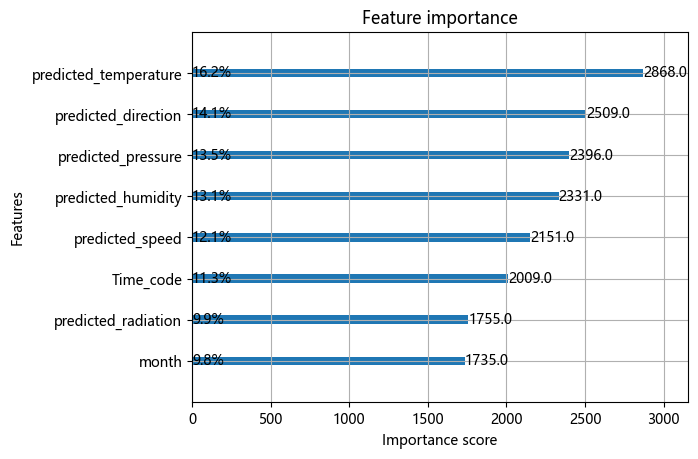

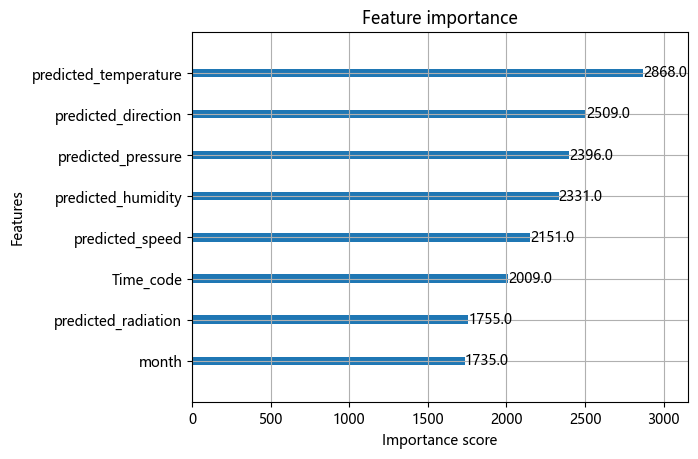

In [20]:
best_model  = model
import matplotlib.pyplot as plt
# 获取特征重要性
importance = best_model.get_booster().get_score(importance_type='weight')

# 将特征重要性转换为百分比
total_importance = sum(importance.values())
importance_percent = {k: (v / total_importance) * 100 for k, v in importance.items()}

# 绘制特征重要性图
xgb.plot_importance(best_model, importance_type='weight', max_num_features=20)

# 修改 y 轴标签为百分比
importance_percent = dict(sorted(importance_percent.items(), key=lambda item: item[1]))
ax = plt.gca()
for c, v in enumerate(importance_percent.values()):
        ax.text(0, c, f"{v:.1f}%", va='center')

plt.show()
# 绘制特征重要性图
xgb.plot_importance(best_model, importance_type='weight', max_num_features=20)
plt.show()

### 月份预测功率预测辐射和实测的对比关系图

均方误差 (MSE)= 113.54975516198033
均方根误差 (RMSE)= 10.655972745928938
R= 0.8178239851155
MBias= 0.33427727558210096


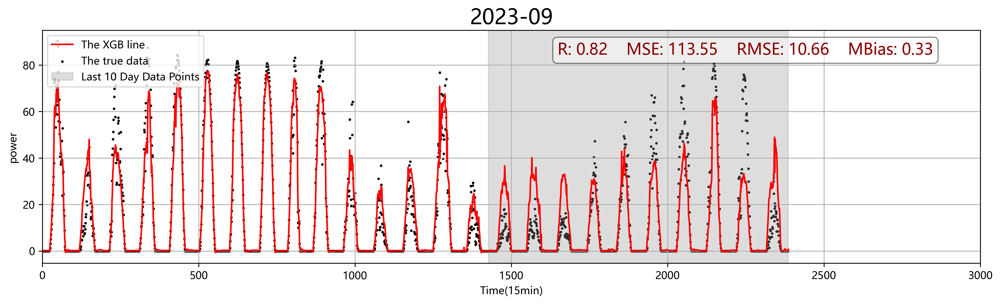

均方误差 (MSE)= 25158.73408865567
均方根误差 (RMSE)= 158.6150500067874
R= 0.550328750616044
MBias= -38.106114546968755


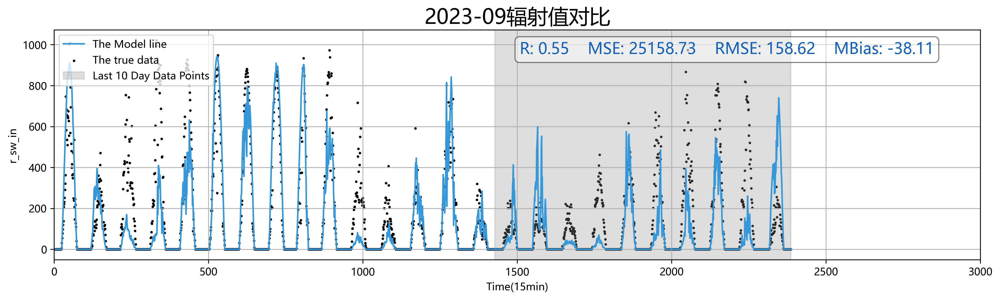

均方误差 (MSE)= 127.54931002688626
均方根误差 (RMSE)= 11.293773064254756
R= 0.9180890416953871
MBias= 3.5781551858936353


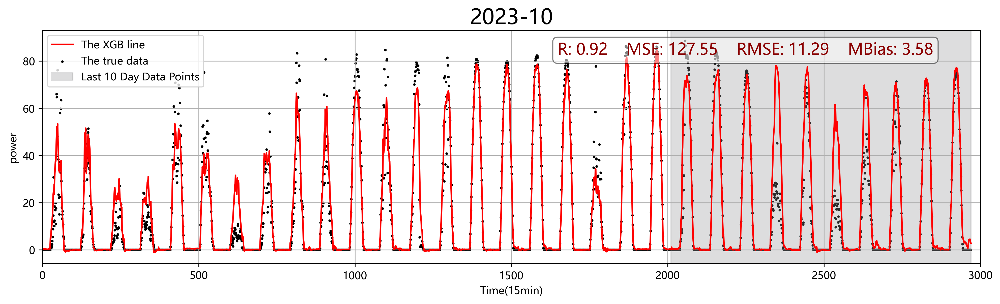

均方误差 (MSE)= 15013.066623072233
均方根误差 (RMSE)= 122.527819792373
R= 0.9300897266186169
MBias= 55.8666455725


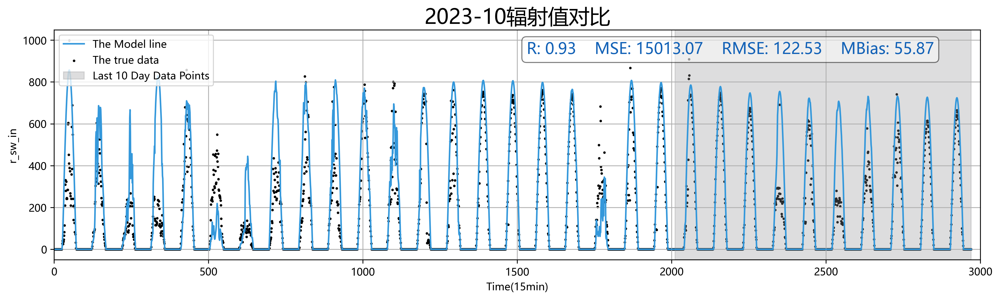

均方误差 (MSE)= 112.79426578868213
均方根误差 (RMSE)= 10.620464480835201
R= 0.9172408022708154
MBias= -1.4565790723412333


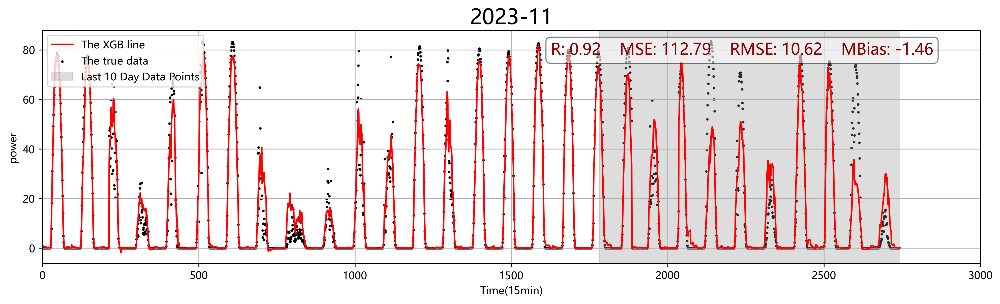

均方误差 (MSE)= 6235.80680147555
均方根误差 (RMSE)= 78.9671248145426
R= 0.9326481831460087
MBias= 18.183644790885417


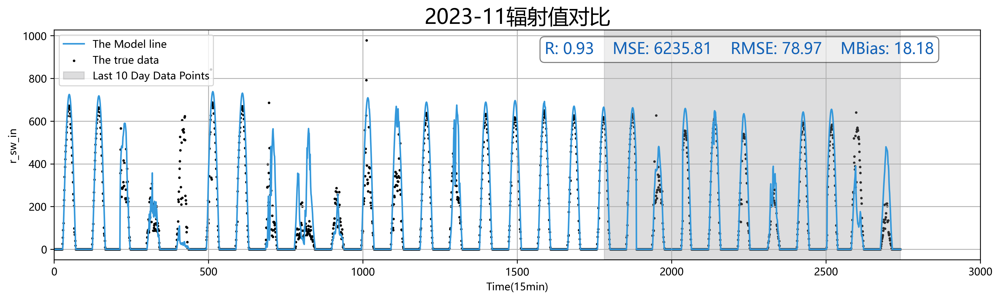

均方误差 (MSE)= 244.99846920906865
均方根误差 (RMSE)= 15.652426943099547
R= 0.8629904831699318
MBias= -5.829550145493053


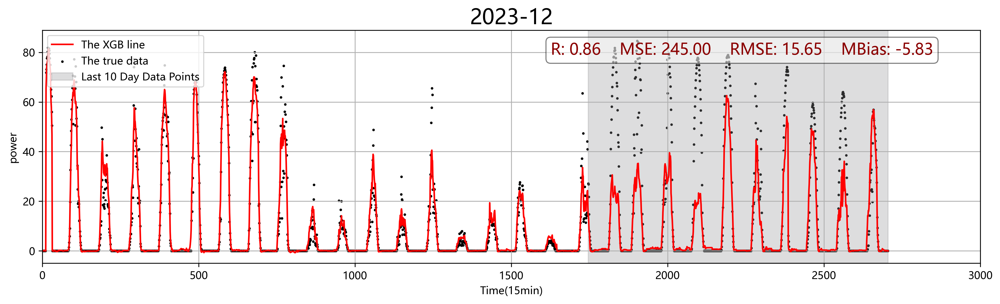

均方误差 (MSE)= 4882.220491072763
均方根误差 (RMSE)= 69.87288809740701
R= 0.9531791922741241
MBias= 17.418153694687497


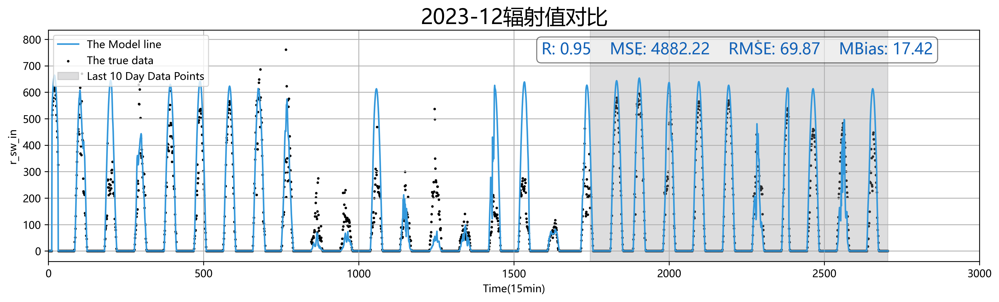

均方误差 (MSE)= 219.80186403133303
均方根误差 (RMSE)= 14.825716307529058
R= 0.7131211816390044
MBias= -0.28139647167364523


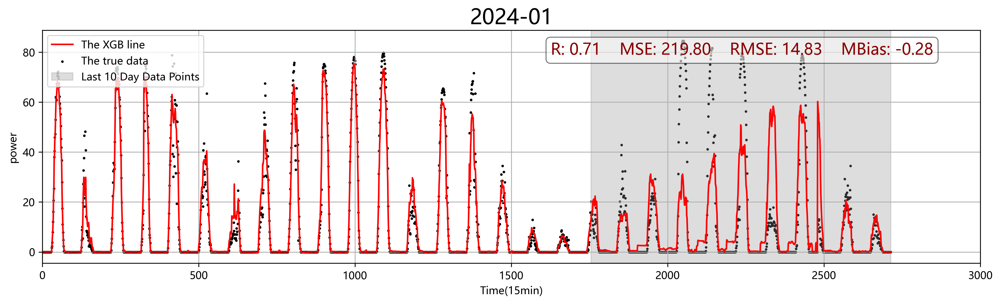

均方误差 (MSE)= 14481.41677910661
均方根误差 (RMSE)= 120.33875842431901
R= 0.8369643006916679
MBias= 33.368664909479165


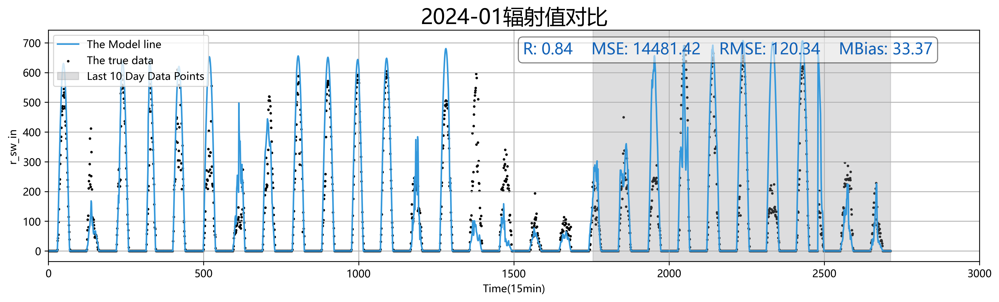

均方误差 (MSE)= 67.07577421969003
均方根误差 (RMSE)= 8.189980111068039
R= 0.7748124306216293
MBias= -0.47298616424605583


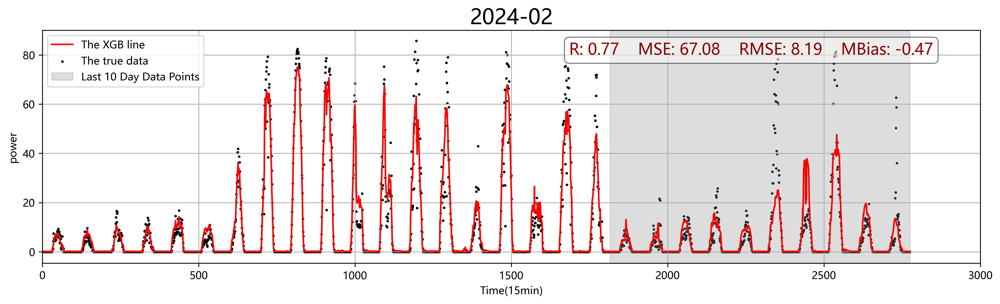

均方误差 (MSE)= 17684.088136036185
均方根误差 (RMSE)= 132.98153306394158
R= 0.8123868504776114
MBias= 40.46188115255938


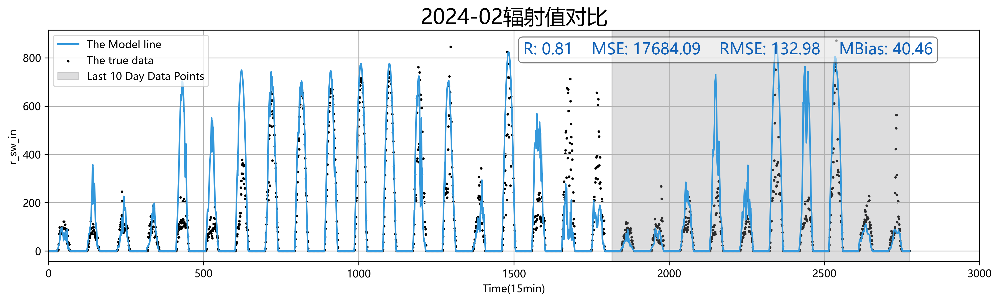

均方误差 (MSE)= 147.80271769883302
均方根误差 (RMSE)= 12.157414104110833
R= 0.9358040326849668
MBias= -4.23965225549334


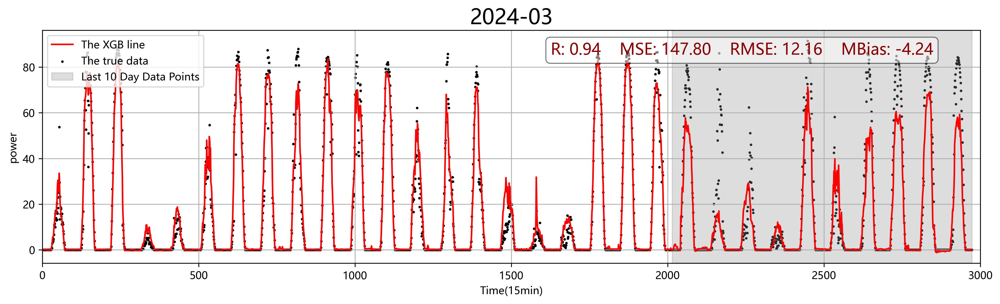

均方误差 (MSE)= 16689.081392281816
均方根误差 (RMSE)= 129.18622756424855
R= 0.8977224584017756
MBias= -2.448811522506253


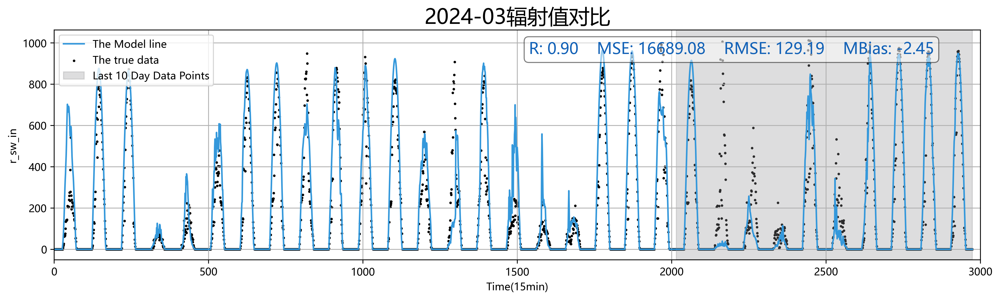

均方误差 (MSE)= 143.54049758692545
均方根误差 (RMSE)= 11.980838768088212
R= 0.8657345129414945
MBias= -1.2757559617541976


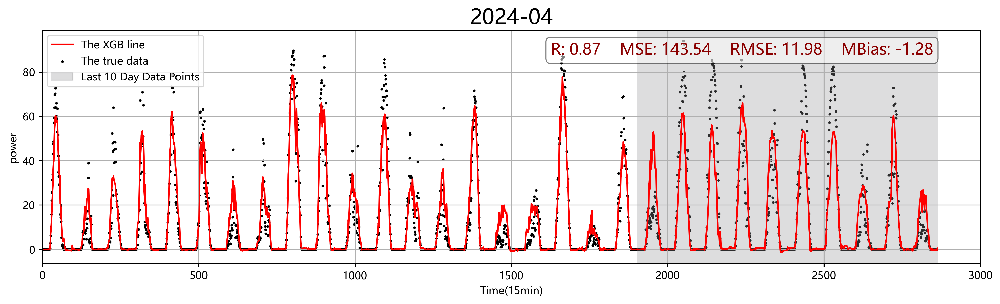

均方误差 (MSE)= 34972.66294810951
均方根误差 (RMSE)= 187.00979372243987
R= 0.8473533825213333
MBias= 64.22102296253124


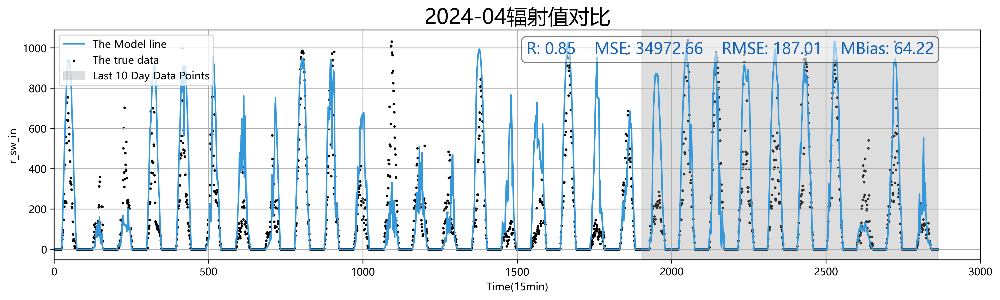

均方误差 (MSE)= 250.71005362646417
均方根误差 (RMSE)= 15.833826247198248
R= 0.6128441332442564
MBias= 7.380601785584248


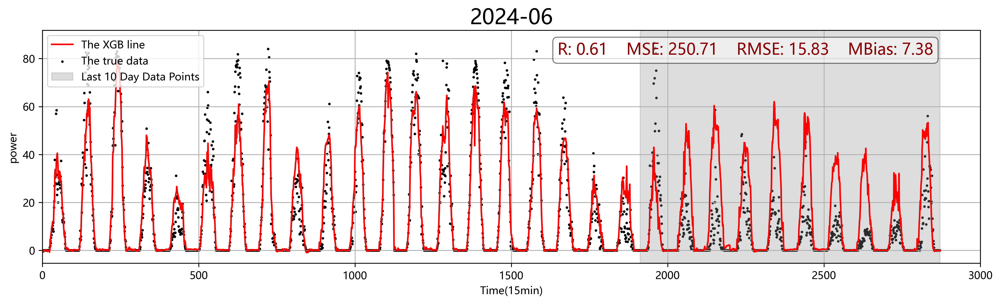

均方误差 (MSE)= 57948.5519825609
均方根误差 (RMSE)= 240.72505474619982
R= 0.4801179270340356
MBias= 88.15071215150002


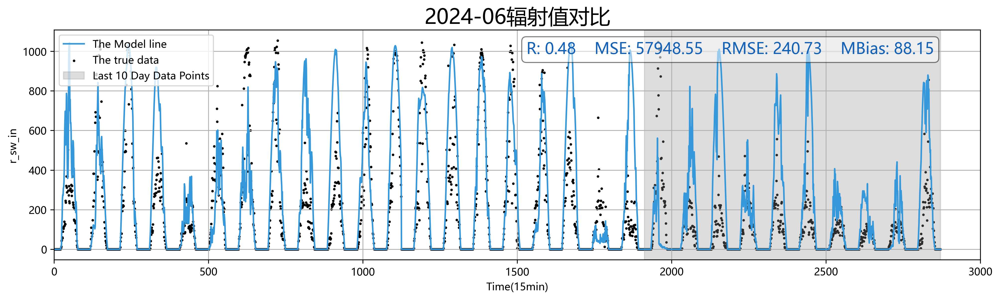

均方误差 (MSE)= 78.08289042748623
均方根误差 (RMSE)= 8.83645236661672
R= 0.9438906243113576
MBias= -0.35466898271476194


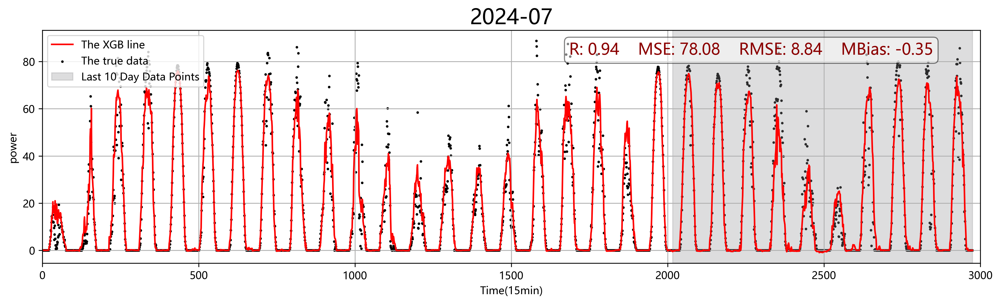

均方误差 (MSE)= 21435.498573844197
均方根误差 (RMSE)= 146.40866973592853
R= 0.8916991217344914
MBias= -1.1299894387291696


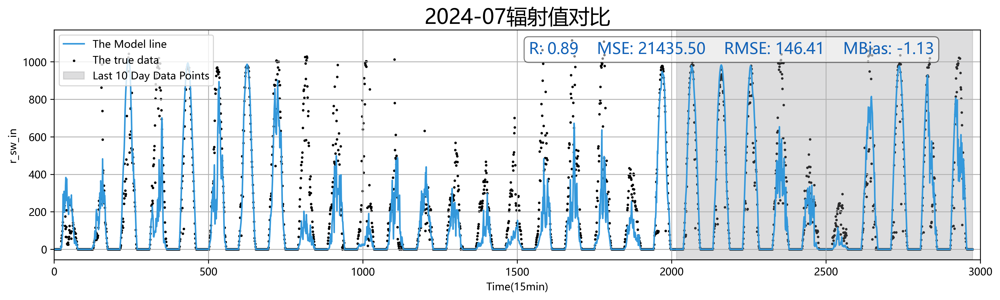

均方误差 (MSE)= 65.30991710300025
均方根误差 (RMSE)= 8.08145513524639
R= 0.9531448652168281
MBias= 0.13390616523939455


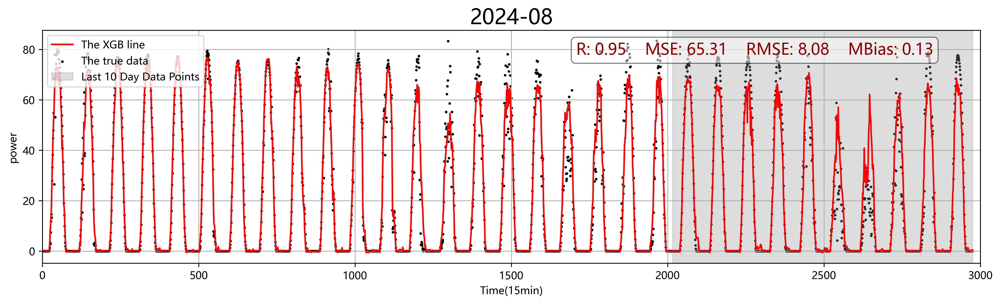

均方误差 (MSE)= 23554.16125771435
均方根误差 (RMSE)= 153.47365004362916
R= 0.8649198855664504
MBias= -34.18637688781249


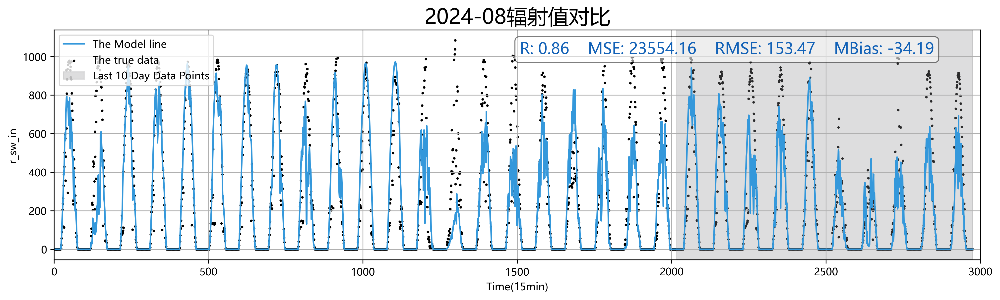

均方误差 (MSE)= 151.39503165067882
均方根误差 (RMSE)= 12.304268838524246
R= 0.9307296561757522
MBias= -4.246117187536834


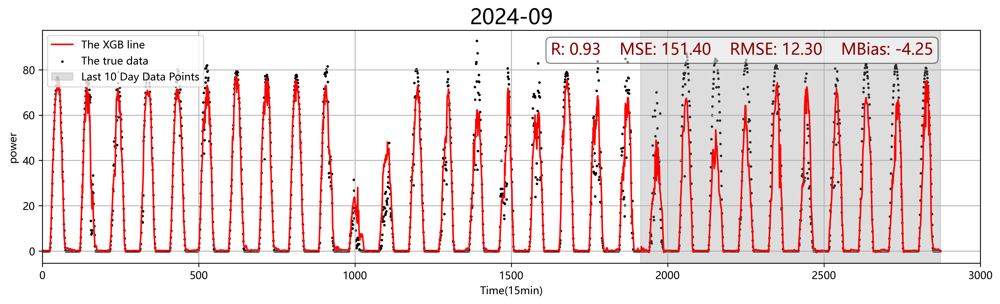

均方误差 (MSE)= 18370.05820119412
均方根误差 (RMSE)= 135.5361877920215
R= 0.8902146789701179
MBias= -6.2451007320833325


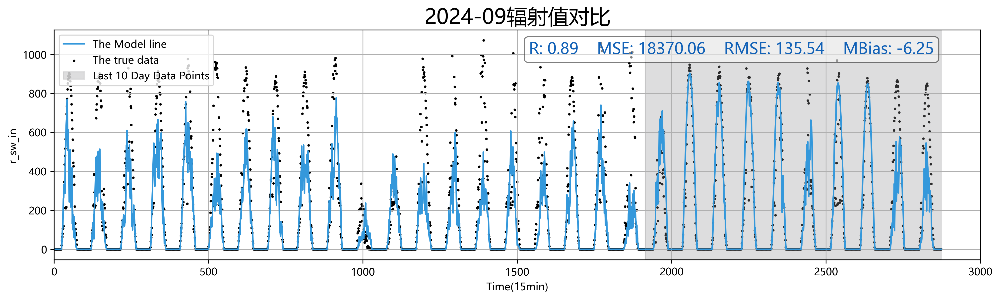

均方误差 (MSE)= 144.1311874377837
均方根误差 (RMSE)= 12.005464898861005
R= 0.9113247953445749
MBias= -2.032103479001914


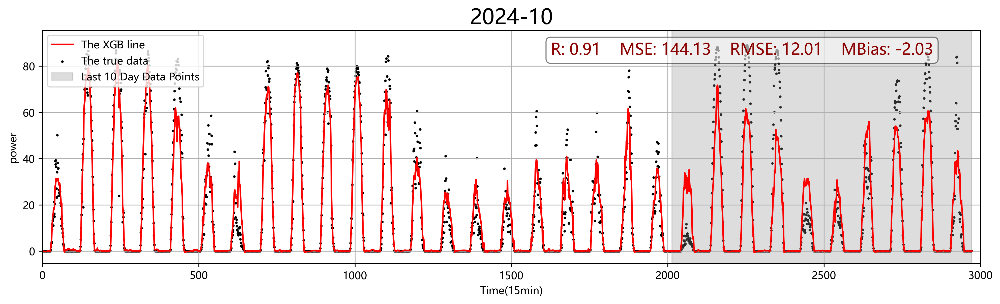

均方误差 (MSE)= 9306.321202863932
均方根误差 (RMSE)= 96.46927595283346
R= 0.9238427067610225
MBias= 22.39795105125


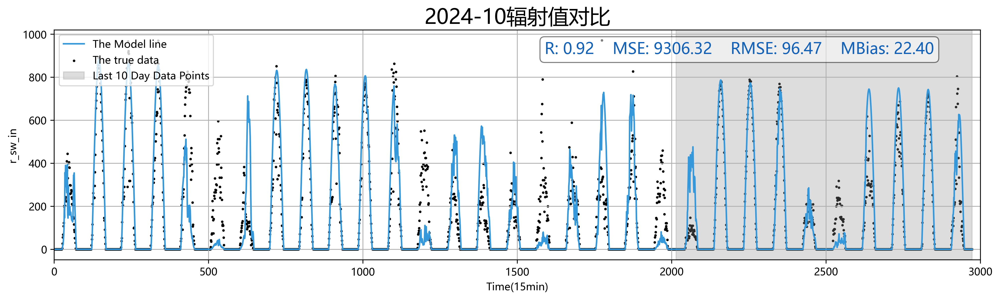

均方误差 (MSE)= 55.389528573601694
均方根误差 (RMSE)= 7.44241416299857
R= 0.9087986003404942
MBias= -3.272211149237663


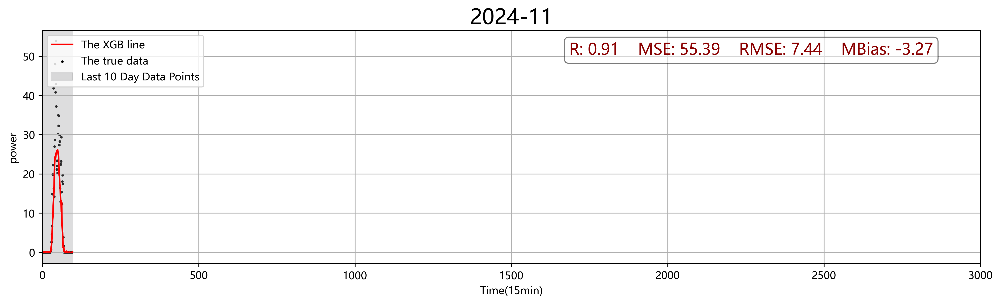

均方误差 (MSE)= 14409.729498010049
均方根误差 (RMSE)= 120.04053272961616
R= 0.9029154368084009
MBias= -70.97734255773196


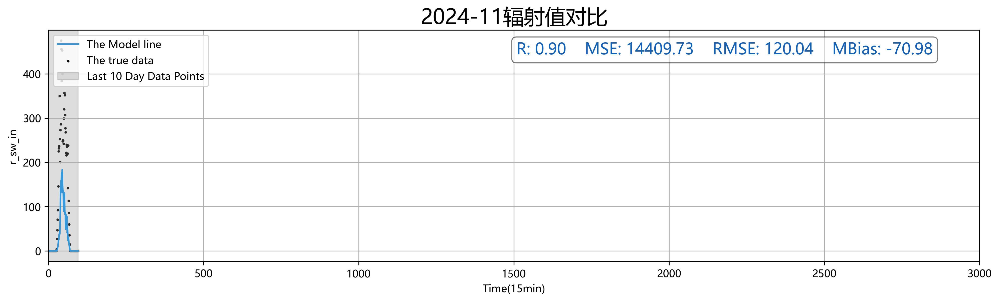

In [ ]:
# for month, group in year_month_groups:
                
#         train_sets = []
#         test_sets = []

#         last_ten_days = group.iloc[-960:].dropna()
#         test_sets.append(last_ten_days)
#         train_sets.append(group.iloc[:-960].dropna())

#         # 合并当前文件的所有月的最后五天数据
#         test_sets_A1 = pd.concat(test_sets)
#         train_sets_A1= pd.concat(train_sets)


#         X_train1= train_sets_A1.loc[:,['Time_code','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
#                                 'predicted_pressure','month']]
        
#         y_train1= train_sets_A1.loc[:, 'power']

#         X_test1= test_sets_A1.loc[:,['Time_code','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
#                                 'predicted_pressure','month']]
        
#         y_test1= test_sets_A1.loc[:, 'power']


#         X_train1, y_train1, X_test1, y_test1

#         r_sw_in_train = train_sets_A1.loc[:,['r_sw_in']]
#         r_sw_in_test = test_sets_A1.loc[:,['r_sw_in']]

#         X = pd.concat([X_train1,X_test1])
#         y = pd.concat([y_train1,y_test1])
#         r_sw_in = pd.concat([r_sw_in_train,r_sw_in_test]).values.flatten()


#         plt.figure(dpi=300,figsize=(16,4))
#         #plt.scatter(train_data.index.tolist(),v, color='#d19a5f',marker='o',s=2.0,label='The WP4 data')  # 绘制散点

#         #d_train = xgb.DMatrix(X)
#         d_train = X

#         plt.plot(range(len(X.index.tolist())),model.predict(d_train),color='red',label='The XGB line')  # 绘制回归线

#         plt.scatter(range(len(X.index.tolist())),y, color='black',marker='o',s=2.0,label='The true data') 

#         plt.grid(True)
#         plt.title(f'{str(month)}', fontsize=20)
#         plt.xlabel('{}'.format('Time(15min)'))
#         plt.ylabel('{}'.format('power'))
#         plt.xlim(0,3000)
#         # plt.ylim(0,12)

#         predict =model.predict(d_train)
#         print("均方误差 (MSE)=", mean_squared_error(predict[-960:],  y[-960:]))
#         mse = mean_squared_error(predict[-960:], y[-960:])
#         print("均方根误差 (RMSE)=", np.sqrt(mean_squared_error(predict[-960:], y[-960:])))
#         rmse =np.sqrt(mean_squared_error (predict[-960:], y[-960:]))
#         r = pearson_correlation_coefficient(predict[-960:], y[-960:])
#         print("R=",r)
#         print('MBias=',np.sum(predict[-960:]- y[-960:])/len(y[-960:]))
#         mbias = np.sum(predict[-960:]- y[-960:])/len(y[-960:])
#         # 在右上角添加指标文本
#         textstr = '    '.join((f'R: {r:.2f}',f'MSE: {mse:.2f}',f'RMSE: {rmse:.2f}',f'MBias: {mbias:.2f}' ))
#         plt.gca().text(0.95, 0.95, textstr, transform=plt.gca().transAxes,
#                         fontsize=15, verticalalignment='top', horizontalalignment='right',color='darkred',
#                         bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))

#         # 最后300个数据点的索引
#         start_idx = len(X) - 960
#         end_idx = len(X)

#         # 用色块标出最后300个数据点的区域
#         plt.axvspan(start_idx, end_idx-1, color='#919193', alpha=0.3, label='Last 10 Day Data Points')
#         # 设置图例在左上角
#         plt.legend(loc='upper left')
#         # 使用从predict_rating导入的save_dir变量
#         save_dir = 'xgb_fig_ph'
#         os.makedirs(save_dir, exist_ok=True)
#         plt.savefig(os.path.join(save_dir, f"AI_{str(month)}.png"), dpi=300, format='png', bbox_inches='tight', pad_inches=0)
#         plt.show()
        
#         plt.figure(dpi=300,figsize=(16,4))

#         #plt.scatter(train_data.index.tolist(),v, color='#d19a5f',marker='o',s=2.0,label='The WP4 data')  # 绘制散点

#         # d_train = xgb.DMatrix(X, label=y)
#         train_sets_A
#         plt.plot(range(len(X.index.tolist())),X['predicted_radiation'],color= '#3498DB',label='The Model line')  # 绘制回归线
#         plt.scatter(range(len(X.index.tolist())),r_sw_in, color='black',marker='o',s=2.0,label='The true data') 

#         plt.grid(True)
#         plt.title(f'{str(month)}辐射值对比', fontsize=20)
#         plt.xlabel('{}'.format('Time(15min)'))
#         plt.ylabel('{}'.format('r_sw_in'))
#         plt.xlim(0,3000)
       



#         predict = X['predicted_radiation']
#         print("均方误差 (MSE)=", mean_squared_error(predict[-960:],  r_sw_in[-960:]))
#         mse = mean_squared_error(predict[-960:], r_sw_in[-960:])
#         print("均方根误差 (RMSE)=", np.sqrt(mean_squared_error(predict[-960:], r_sw_in[-960:])))
#         rmse =np.sqrt(mean_squared_error(predict[-960:], r_sw_in[-960:]))
#         r = pearson_correlation_coefficient(predict[-960:], r_sw_in[-960:])
#         print("R=",r)
#         print('MBias=',np.sum(predict[-960:]- r_sw_in[-960:])/len(r_sw_in[-960:]))
#         mbias = np.sum(predict[-960:]- r_sw_in[-960:])/len(y[-960:])
#         # 在右上角添加指标文本
#         textstr = '    '.join((f'R: {r:.2f}',f'MSE: {mse:.2f}',f'RMSE: {rmse:.2f}',f'MBias: {mbias:.2f}' ))
#         plt.gca().text(0.95, 0.95, textstr, transform=plt.gca().transAxes,
#                         fontsize=15, verticalalignment='top', horizontalalignment='right',color='#1362b7',
#                         bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))
#         # 最后300个数据点的索引
#         # 最后300个数据点的索引
#         start_idx = len(X) - 960
#         end_idx = len(X)


#         # 用色块标出最后300个数据点的区域
#         plt.axvspan(start_idx, end_idx-1, color='#919193', alpha=0.3, label='Last 10 Day Data Points')
#         # 设置图例在左上角
#         plt.legend(loc='upper left')

#         plt.savefig(os.path.join(save_dir, f"r_sw_in_{str(month)}.png"), dpi=300, format='png', bbox_inches='tight', pad_inches=0)
#         plt.show()

        

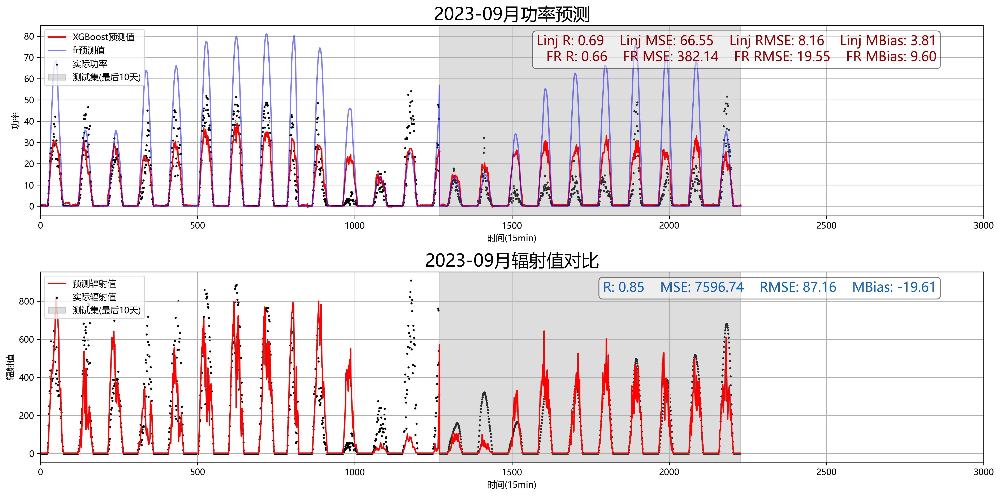

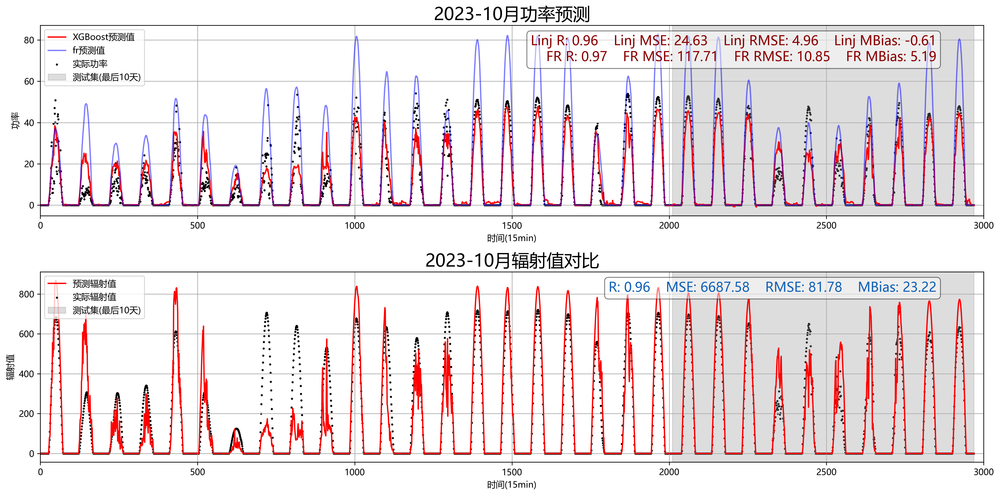

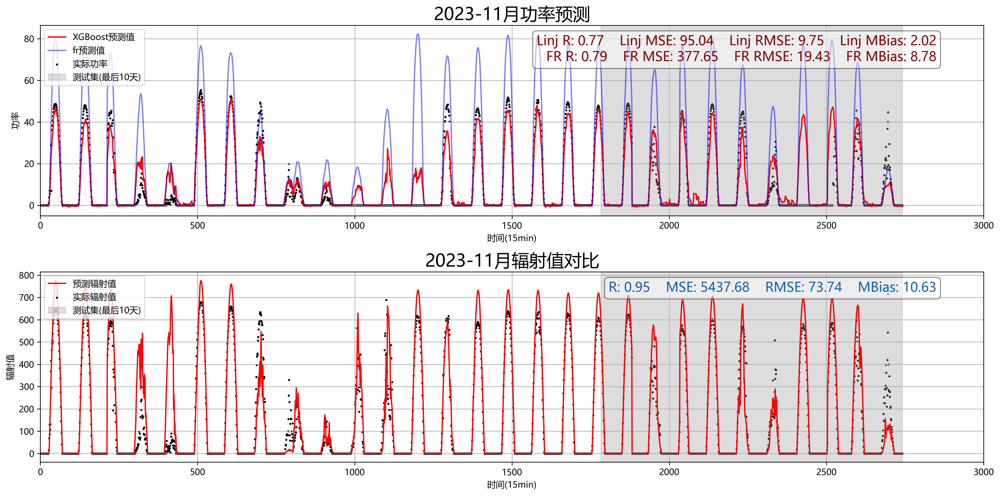

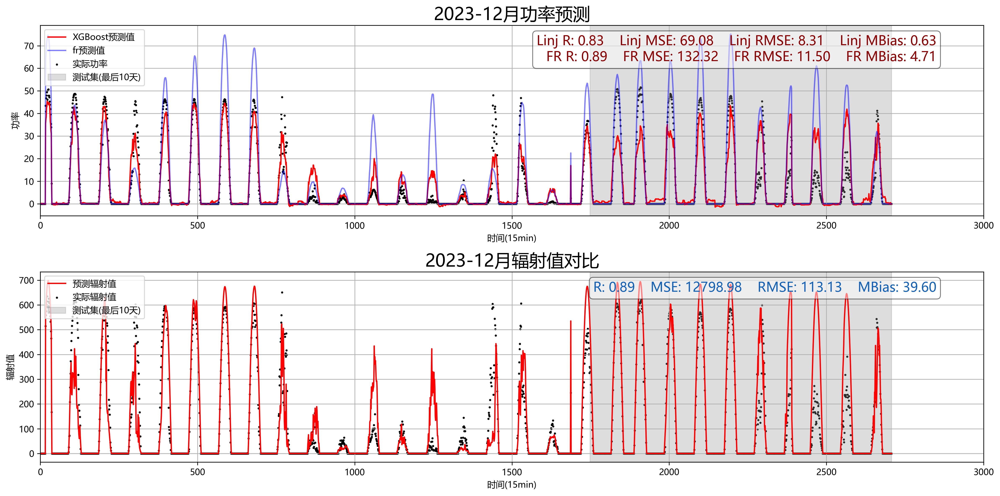

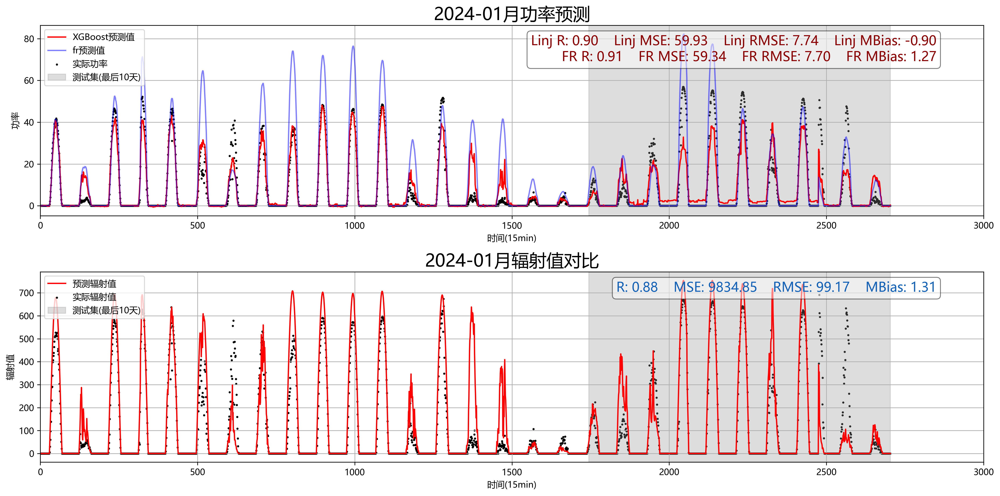

...

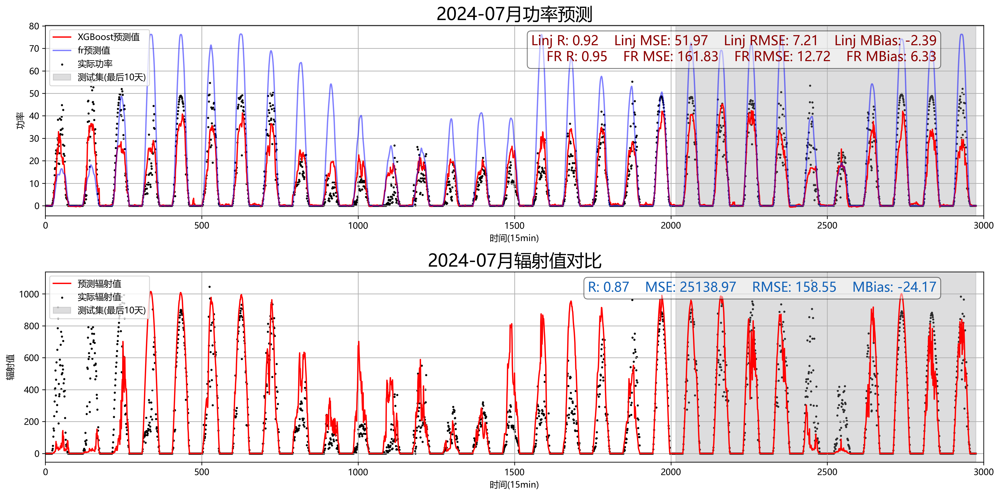

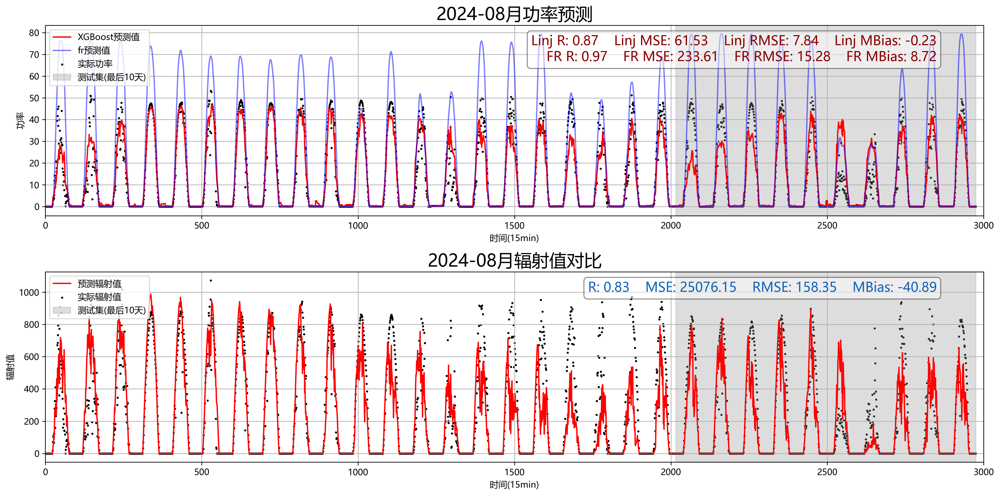

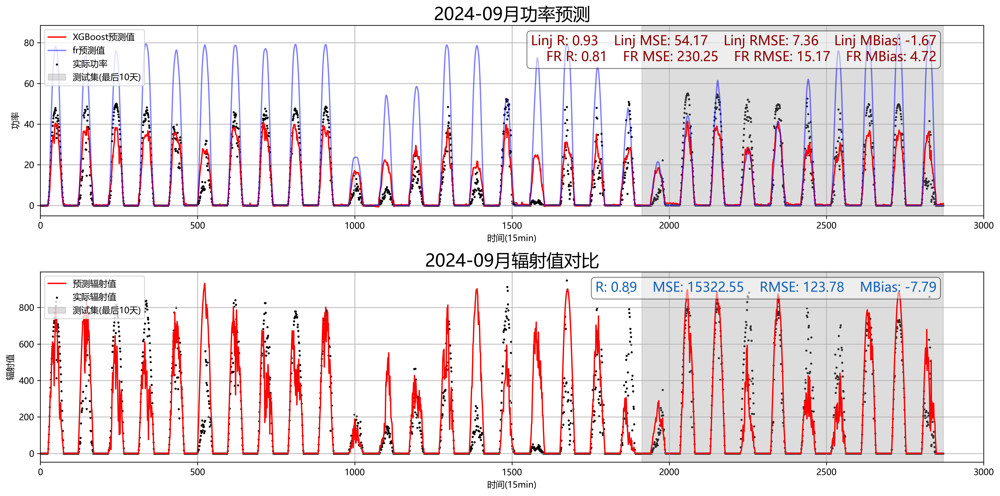

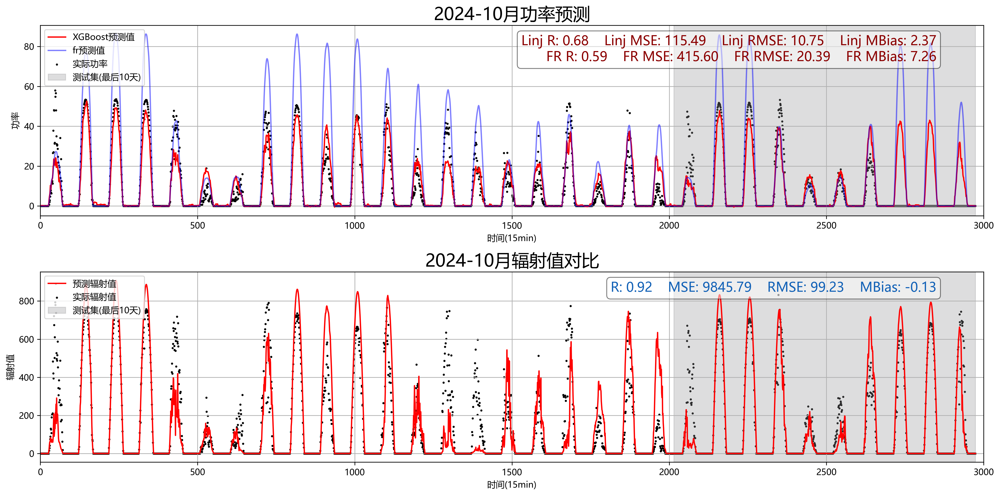

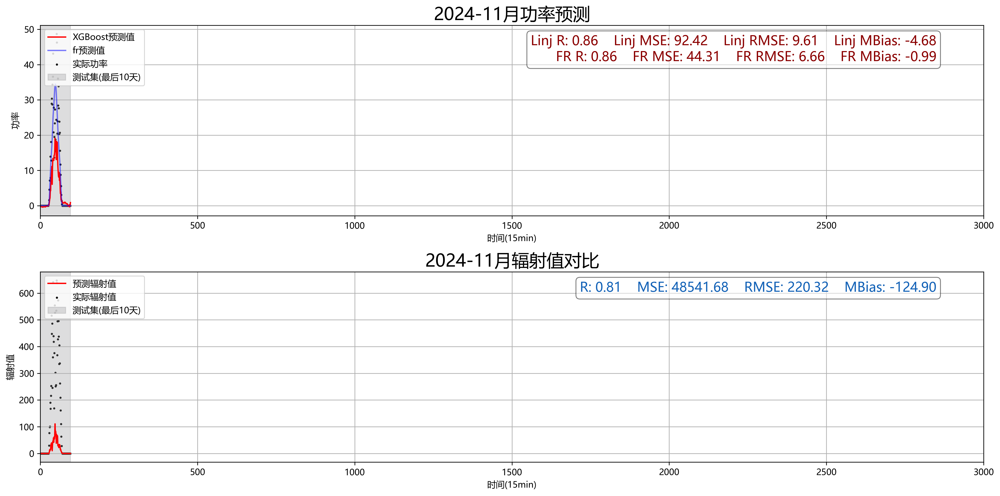

In [27]:
for month, group in year_month_groups:
                
        train_sets = []
        test_sets = []

        last_ten_days = group.iloc[-960:].dropna()
        test_sets.append(last_ten_days)
        train_sets.append(group.iloc[:-960].dropna())

        # 合并当前文件的所有月的最后五天数据
        test_sets_A1 = pd.concat(test_sets)
        train_sets_A1= pd.concat(train_sets)


        X_train1= train_sets_A1.loc[:,['Time_code','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
                                'predicted_pressure','month']]
        
        y_train1= train_sets_A1.loc[:, 'power']

        X_test1= test_sets_A1.loc[:,['Time_code','predicted_radiation','predicted_direction','predicted_speed','predicted_temperature','predicted_humidity',
                                'predicted_pressure','month']]
        
        y_test1= test_sets_A1.loc[:, 'power']


        X_train1, y_train1, X_test1, y_test1

        r_sw_in_train = train_sets_A1.loc[:,['r_sw_in']]
        r_sw_in_test = test_sets_A1.loc[:,['r_sw_in']]

        fr_sw_train = train_sets_A1.loc[:,['power_fr']]
        fr_sw_test = test_sets_A1.loc[:,['power_fr']]

        X = pd.concat([X_train1,X_test1])
        y = pd.concat([y_train1,y_test1])
        r_sw_in = pd.concat([r_sw_in_train,r_sw_in_test]).values.flatten()
        fr_sw = pd.concat([fr_sw_train,fr_sw_test]).values.flatten()

        # 创建一个包含两个子图的图表
        fig, axes = plt.subplots(2, 1, figsize=(16, 8), dpi=300)
        d_train = X
        # 第一个子图：XGBoost模型预测结果
        axes[0].plot(range(len(X.index.tolist())), model.predict(d_train), color='red', label='XGBoost预测值')
        axes[0].plot(range(len(X.index.tolist())), fr_sw, color='blue', alpha=0.5, label='fr预测值')
        axes[0].scatter(range(len(X.index.tolist())), y, color='black', marker='o', s=2.0, label='实际功率')
        axes[0].grid(True)
        axes[0].set_title(f'{str(month)}月功率预测', fontsize=20)
        axes[0].set_xlabel('时间(15min)')
        axes[0].set_ylabel('功率')
        axes[0].set_xlim(0, 3000)
        predict = model.predict(d_train)
        # 计算第一个子图的评估指标
        mse = mean_squared_error(predict[-960:], y[-960:]) 
        mse_fr = mean_squared_error(fr_sw[-960:], y[-960:]) 
        rmse = np.sqrt(mean_squared_error(predict[-960:], y[-960:])) 
        rmse_fr = np.sqrt(mean_squared_error(fr_sw[-960:], y[-960:])) 
        r = pearson_correlation_coefficient(predict[-960:], y[-960:]) 
        r_fr = pearson_correlation_coefficient(fr_sw[-960:], y[-960:]) 
        mbias = np.sum(predict[-960:] - y[-960:])/len(y[-960:]) 
        mbias_fr = np.sum(fr_sw[-960:] - y[-960:])/len(y[-960:]) 
        # 创建评估指标数据字典 
        metrics_data = { 
                'Month': [month], 
                'Linj_MSE': [mse], 
                'FR_MSE': [mse_fr], 
                'Linj_RMSE': [rmse], 
                'FR_RMSE': [rmse_fr], 
                'Linj_R': [r], 
                'FR_R': [r_fr], 
                'Linj_MBias': [mbias], 
                'FR_MBias': [mbias_fr] 
        } 
        # 创建DataFrame并保存到CSV 
        metrics_df = pd.DataFrame(metrics_data) 

        # 检查文件是否存在 
        csv_path = 'site_linj_compare_FR.csv' 
        if os.path.exists(csv_path): 
        # 如果文件存在，追加数据 
                metrics_df.to_csv(csv_path, mode='a', header=False, index=False) 
        else: 
        # 如果文件不存在，创建新文件 
                metrics_df.to_csv(csv_path, index=False) 
        # 在右上角添加指标文本 
        # 生成Linj模型的评估指标文本 
        linj_textstr = '    '.join((f'Linj R: {r:.2f}',f'Linj MSE: {mse:.2f}',f'Linj RMSE: {rmse:.2f}',f'Linj MBias: {mbias:.2f}' )) 
        # 生成ph模型的评估指标文本 
        fr_textstr = '    '.join((f'FR R: {r_fr:.2f}',f'FR MSE: {mse_fr:.2f}',f'FR RMSE: {rmse_fr:.2f}',f'FR MBias: {mbias_fr:.2f}' )) 
        # 合并两行评估指标 
        textstr = linj_textstr + '\n' + fr_textstr
        axes[0].text(0.95, 0.95, textstr, transform=axes[0].transAxes,
                    fontsize=15, verticalalignment='top', horizontalalignment='right', color='darkred',
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))
        
        # 在第一个子图中标记测试集区域
        start_idx = len(X) - 960
        end_idx = len(X)
        axes[0].axvspan(start_idx, end_idx-1, color='#919193', alpha=0.3, label='测试集(最后10天)')
        axes[0].legend(loc='upper left')
        
        # 第二个子图：辐射值对比
        axes[1].plot(range(len(X.index.tolist())), X['predicted_radiation'], color='red', label='预测辐射值')
        axes[1].scatter(range(len(X.index.tolist())), r_sw_in, color='black', marker='o', s=2.0, label='实际辐射值')
        axes[1].grid(True)
        axes[1].set_title(f'{str(month)}月辐射值对比', fontsize=20)
        axes[1].set_xlabel('时间(15min)')
        axes[1].set_ylabel('辐射值')
        axes[1].set_xlim(0, 3000)
        
        # 计算第二个子图的评估指标
        predict = X['predicted_radiation']
        mse = mean_squared_error(predict[-960:], r_sw_in[-960:])
        rmse = np.sqrt(mean_squared_error(predict[-960:], r_sw_in[-960:]))
        r = pearson_correlation_coefficient(predict[-960:], r_sw_in[-960:])
        mbias = np.sum(predict[-960:] - r_sw_in[-960:]) / len(r_sw_in[-960:])
        
        # 在第二个子图右上角添加指标文本
        textstr = '    '.join((f'R: {r:.2f}', f'MSE: {mse:.2f}', f'RMSE: {rmse:.2f}', f'MBias: {mbias:.2f}'))
        axes[1].text(0.95, 0.95, textstr, transform=axes[1].transAxes,
                    fontsize=15, verticalalignment='top', horizontalalignment='right', color='#1362b7',
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.5))
        
        # 在第二个子图中标记测试集区域
        axes[1].axvspan(start_idx, end_idx-1, color='#919193', alpha=0.3, label='测试集(最后10天)')
        axes[1].legend(loc='upper left')
        
        # 调整子图之间的间距
        plt.tight_layout()
        
        # 保存图表
        save_dir = 'xgb_fig_fr_merge'
        os.makedirs(save_dir, exist_ok=True)
        plt.savefig(os.path.join(save_dir, f"combined_{str(month)}.png"), dpi=300, format='png', bbox_inches='tight', pad_inches=0)
        plt.show()

## 对比评估

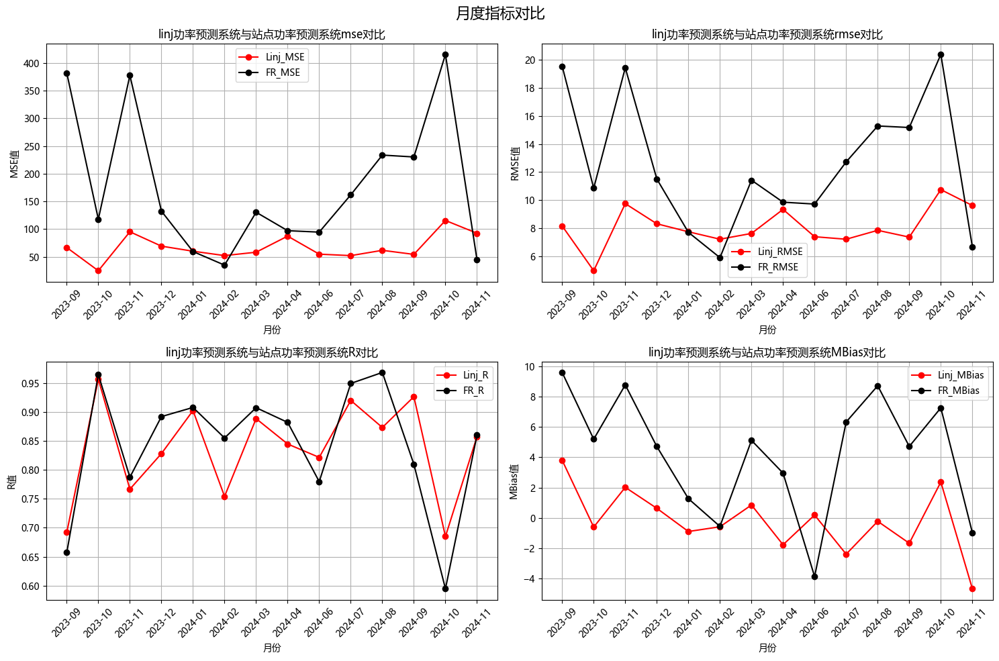

In [28]:
file_path = r'E:\Power_Pre_Model\site_linj_compare_FR.csv'

# 读取数据（假设数据分隔符为空格）
total_df = pd.read_csv(
    file_path,
    header=0,
    low_memory=False,
)

# 创建子图
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('月度指标对比', fontsize=16)

# 绘制第一个子图 - mse对比
axes[0,0].plot(total_df['Month'], total_df['Linj_MSE'], marker='o',label='Linj_MSE',color='red')
axes[0,0].plot(total_df['Month'], total_df['FR_MSE'], marker='o',label='FR_MSE',color='black')
axes[0,0].set_title('linj功率预测系统与站点功率预测系统mse对比')
axes[0,0].set_xlabel('月份')
axes[0,0].set_ylabel('MSE值')
axes[0,0].legend()
plt.setp(axes[0,0].get_xticklabels(), rotation=45)

axes[0,0].grid(True)

# 绘制第二个子图 - RMSE对比
axes[0,1].plot(total_df['Month'], total_df['Linj_RMSE'], marker='o',label='Linj_RMSE',color='red')
axes[0,1].plot(total_df['Month'], total_df['FR_RMSE'], marker='o',label='FR_RMSE',color='black')
axes[0,1].set_title('linj功率预测系统与站点功率预测系统rmse对比')
axes[0,1].set_xlabel('月份')
axes[0,1].set_ylabel('RMSE值')
axes[0,1].legend()
plt.setp(axes[0,1].get_xticklabels(), rotation=45)
axes[0,1].grid(True)

# 绘制第三个子图 - R对比
axes[1,0].plot(total_df['Month'], total_df['Linj_R'], marker='o',label='Linj_R',color='red')
axes[1,0].plot(total_df['Month'], total_df['FR_R'], marker='o',label='FR_R',color='black')
axes[1,0].set_title('linj功率预测系统与站点功率预测系统R对比')
axes[1,0].set_xlabel('月份')
axes[1,0].set_ylabel('R值')
axes[1,0].legend()
plt.setp(axes[1,0].get_xticklabels(), rotation=45)
axes[1,0].grid(True)

# 绘制第四个子图 - 预测PR
axes[1,1].plot(total_df['Month'], total_df['Linj_MBias'], marker='o',label='Linj_MBias',color='red')
axes[1,1].plot(total_df['Month'], total_df['FR_MBias'], marker='o',label='FR_MBias',color='black')
axes[1,1].set_title('linj功率预测系统与站点功率预测系统MBias对比')
axes[1,1].set_xlabel('月份')
axes[1,1].set_ylabel('MBias值')
axes[1,1].legend()
plt.setp(axes[1,1].get_xticklabels(), rotation=45)
axes[1,1].grid(True)

# 调整子图布局
plt.tight_layout()

save_dir = 'month_compare_fr'
os.makedirs(save_dir, exist_ok=True)  # 创建保存目录，若不存在则创建
plt.savefig(os.path.join(save_dir, f"month_compare_fr.png"), dpi=500, format='png', bbox_inches='tight', pad_inches=0)
plt.show()
